In [1]:
# Define the file ID and output file name
file_id = '1sjFX72l40hNTEShBv_2Q3Fr8bZfmbUZf'
output_file = '/content/custom_model_lite.zip'

# Create the download link
download_link = f'https://drive.google.com/uc?id={file_id}'

# Download the file using gdown
!gdown {download_link} -O {output_file}

# Unzip the downloaded file
!unzip {output_file} -d /content/custom_model_lite


Downloading...
From: https://drive.google.com/uc?id=1sjFX72l40hNTEShBv_2Q3Fr8bZfmbUZf
To: /content/custom_model_lite.zip
100% 20.8M/20.8M [00:00<00:00, 24.8MB/s]
Archive:  /content/custom_model_lite.zip
   creating: /content/custom_model_lite/custom_model_lite/
  inflating: /content/custom_model_lite/custom_model_lite/labelmap.pbtxt  
 extracting: /content/custom_model_lite/custom_model_lite/labelmap.txt  
  inflating: /content/custom_model_lite/custom_model_lite/pipeline_file.config  
  inflating: /content/custom_model_lite/custom_model_lite/detect.tflite  
   creating: /content/custom_model_lite/custom_model_lite/saved_model/
  inflating: /content/custom_model_lite/custom_model_lite/saved_model/saved_model.pb  
   creating: /content/custom_model_lite/custom_model_lite/saved_model/assets/
   creating: /content/custom_model_lite/custom_model_lite/saved_model/variables/
  inflating: /content/custom_model_lite/custom_model_lite/saved_model/variables/variables.index  
  inflating: /conten

In [4]:


file_id = '1bhhumTP15XbNPFq4mdyTNiVciapEcdXU'  # Replace with your actual file ID

# Construct the download link
download_link = f'https://drive.google.com/uc?id={file_id}'

# Download the file using gdown
output_path = '/content/images.zip'  # Specify the output path
!gdown $download_link -O $output_path


Downloading...
From: https://drive.google.com/uc?id=1bhhumTP15XbNPFq4mdyTNiVciapEcdXU
To: /content/images.zip
100% 239M/239M [00:01<00:00, 164MB/s]


In [19]:
!mkdir /content/images
!unzip -q images.zip -d /content/images/all
!mkdir /content/images/train; mkdir /content/images/validation; mkdir /content/images/test

In [20]:
!wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/train_val_test_split.py
!python train_val_test_split.py

--2023-11-28 13:25:30--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/train_val_test_split.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2803 (2.7K) [text/plain]
Saving to: ‘train_val_test_split.py’

train_val_test_spli 100%[===================>]   2.74K  --.-KB/s    in 0s      

2023-11-28 13:25:30 (32.0 MB/s) - ‘train_val_test_split.py’ saved [2803/2803]

Total images: 86
Images moving to train: 68
Images moving to validation: 8
Images moving to test: 10


In [21]:
# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  # Grab filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.bmp')
  print(images)
  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])
      # Print the number of objects detected
      print(f'Number of objects detected in {os.path.basename(image_path)}: {len(detections)}')

      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

['/content/images/test/20231121_115329.jpg', '/content/images/test/20231121_115636.jpg', '/content/images/test/20231121_120036.jpg', '/content/images/test/IMG-20231017-WA0039.jpg', '/content/images/test/20231121_123331.jpg', '/content/images/test/20231121_122327.jpg', '/content/images/test/20231121_120042.jpg', '/content/images/test/20231121_115612.jpg', '/content/images/test/20231121_114711.jpg', '/content/images/test/20231121_122420.jpg']
Number of objects detected in 20231121_115636.jpg: 0


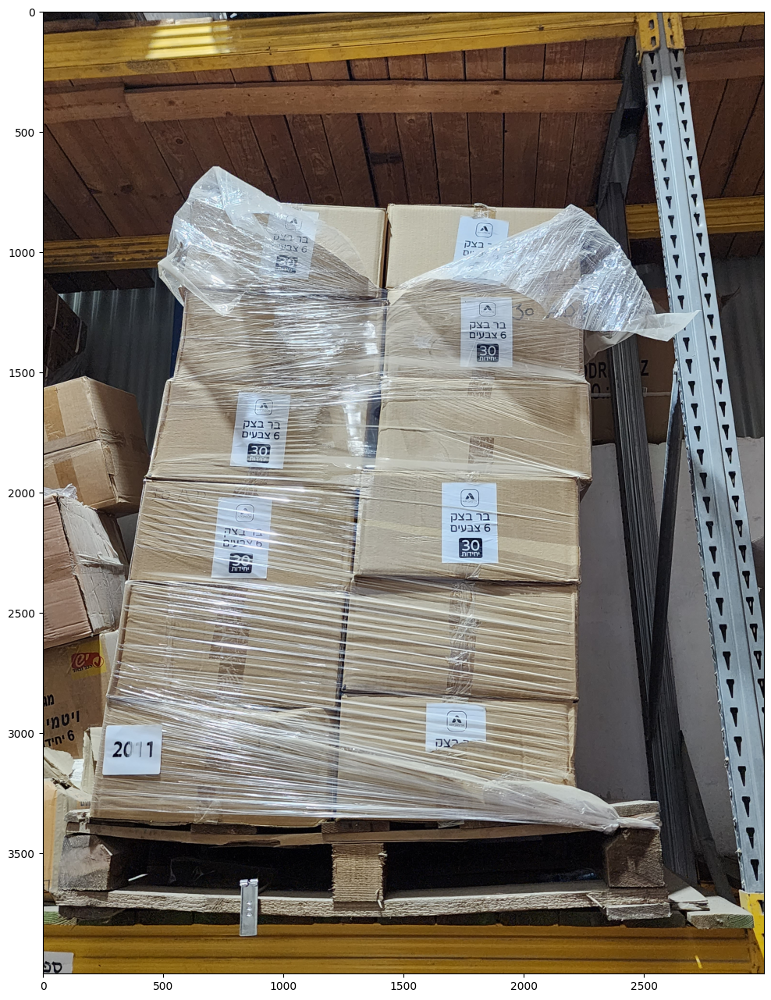

Number of objects detected in 20231121_123331.jpg: 1


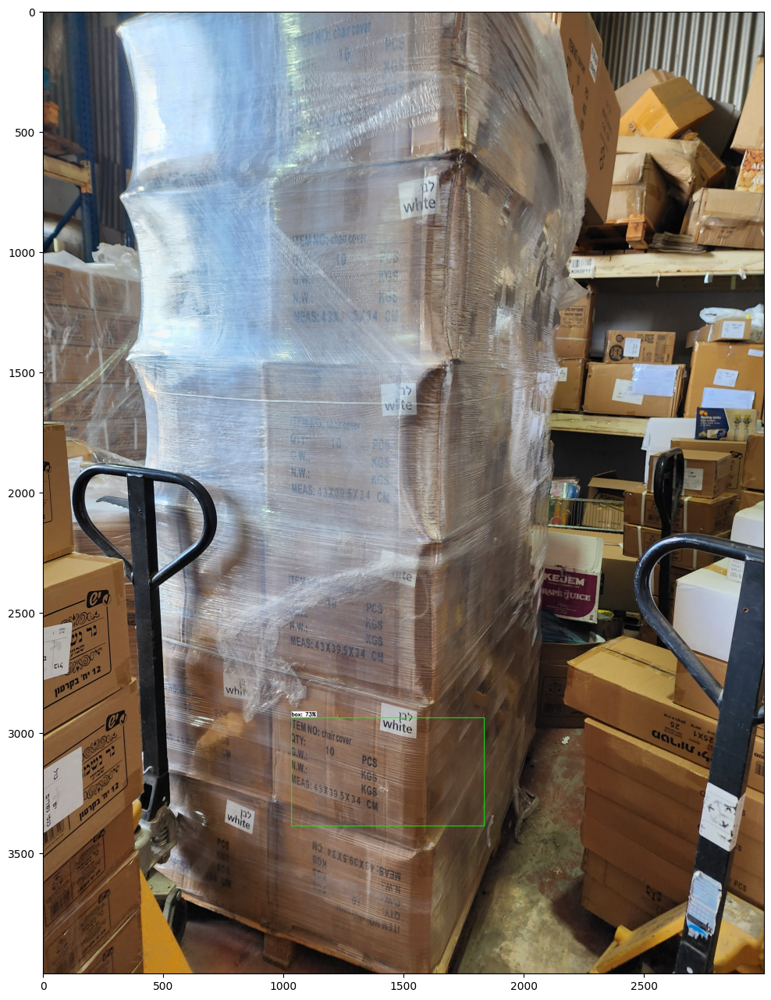

Number of objects detected in 20231121_120036.jpg: 1


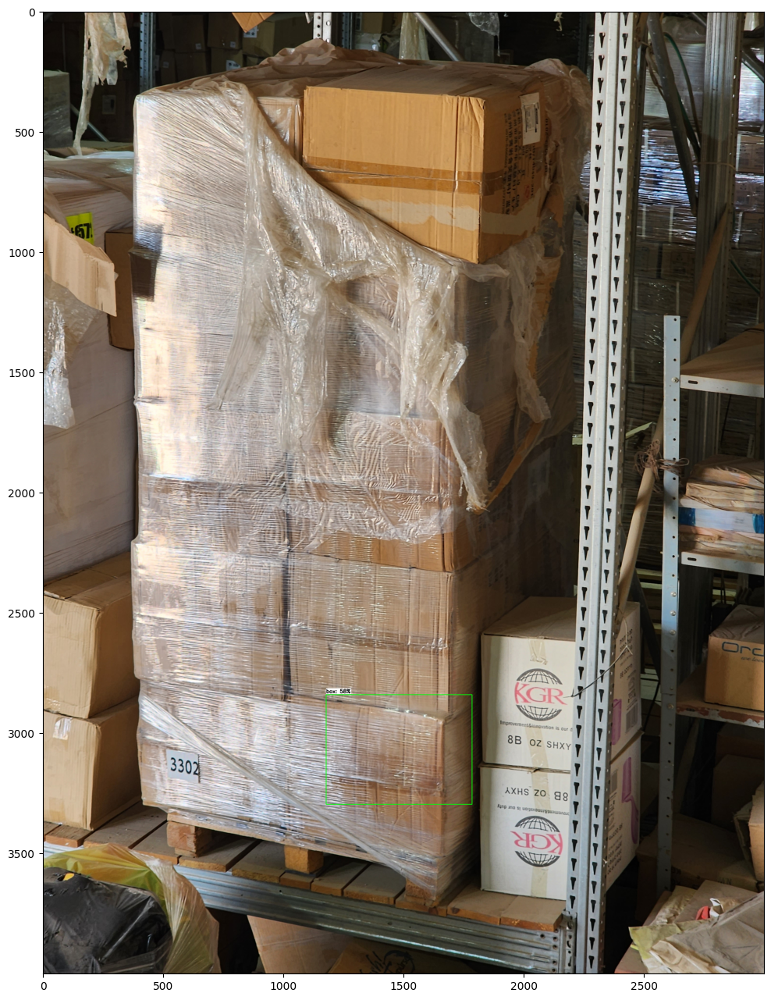

Number of objects detected in 20231121_122420.jpg: 1


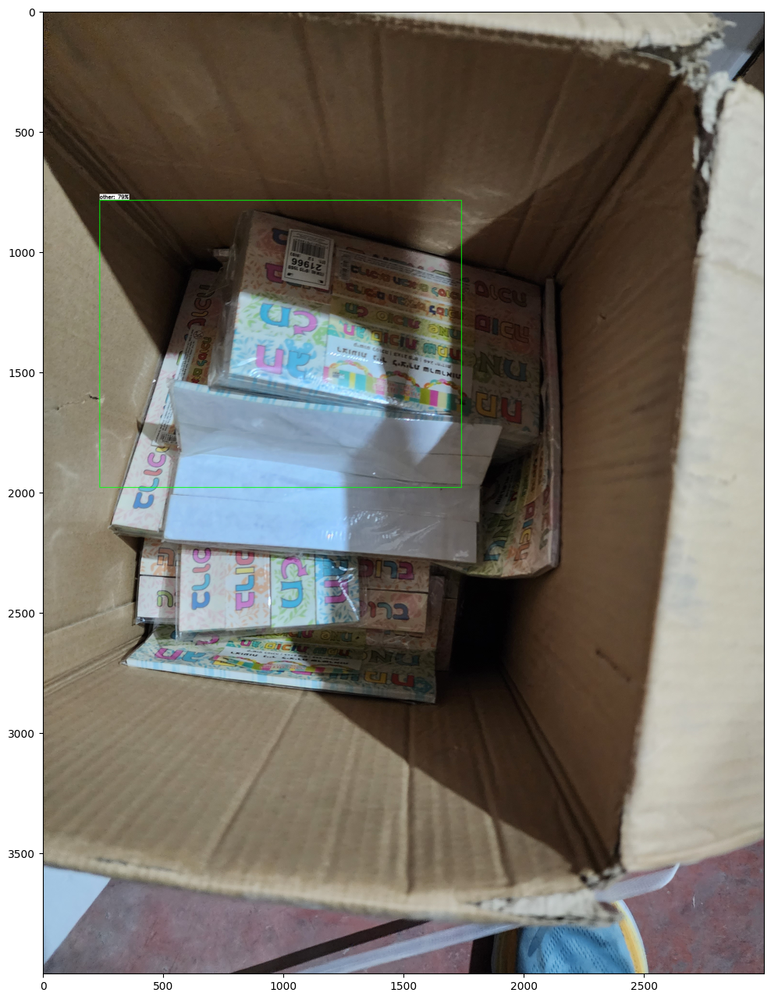

Number of objects detected in 20231121_122327.jpg: 2


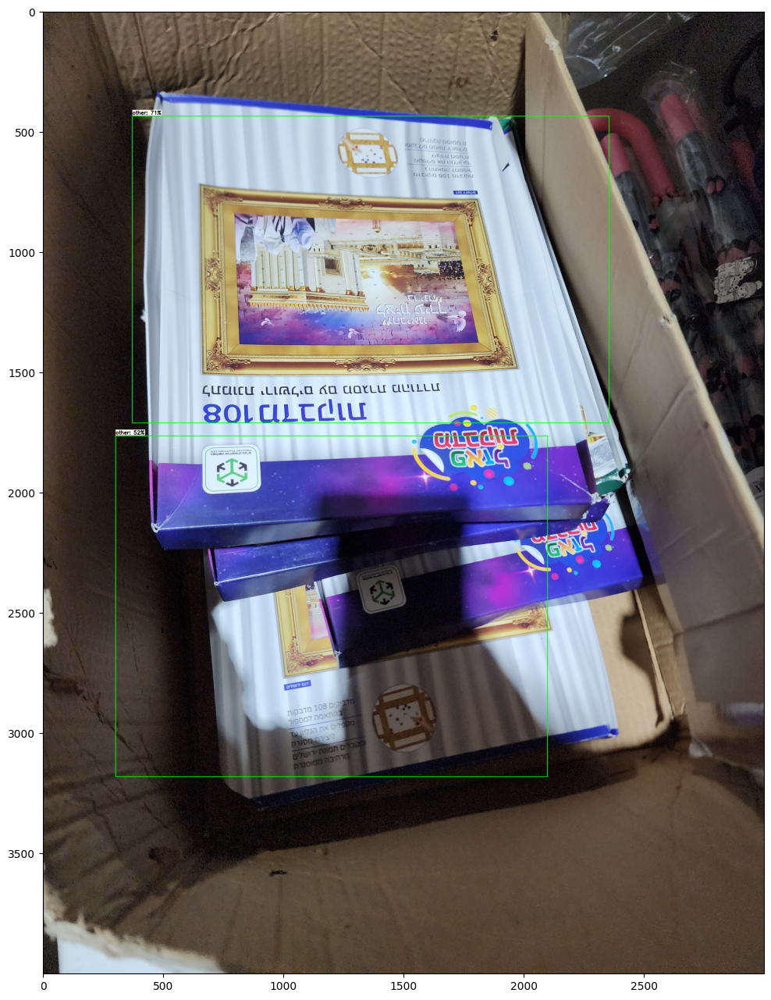

Number of objects detected in 20231121_115329.jpg: 0


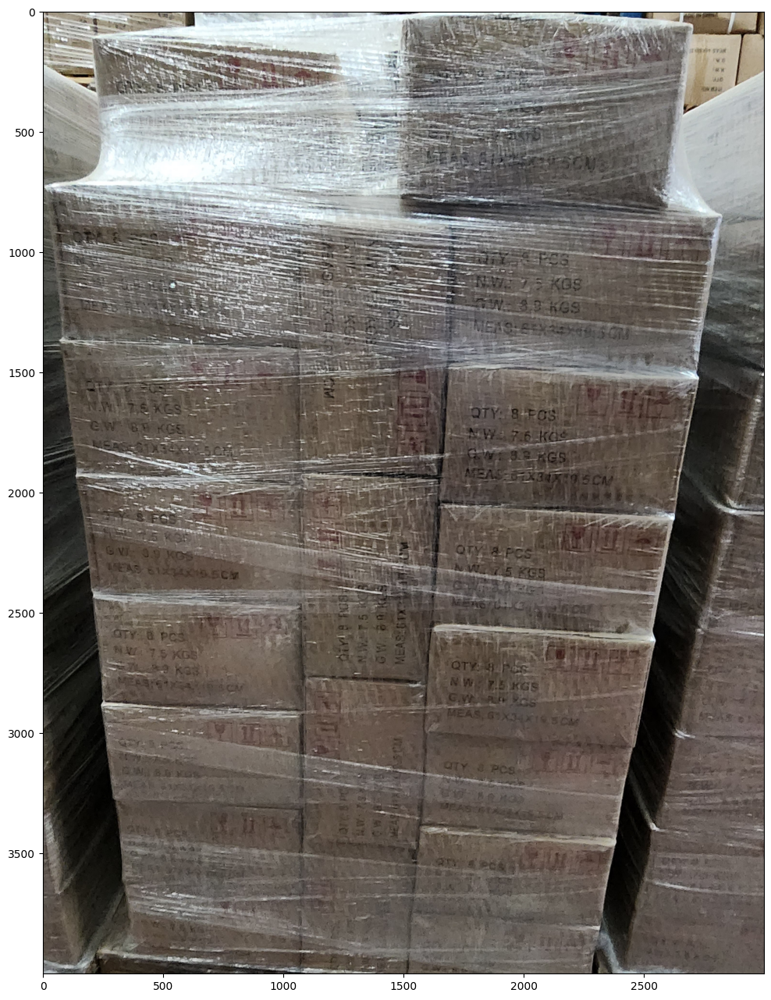

Number of objects detected in IMG-20231017-WA0039.jpg: 8


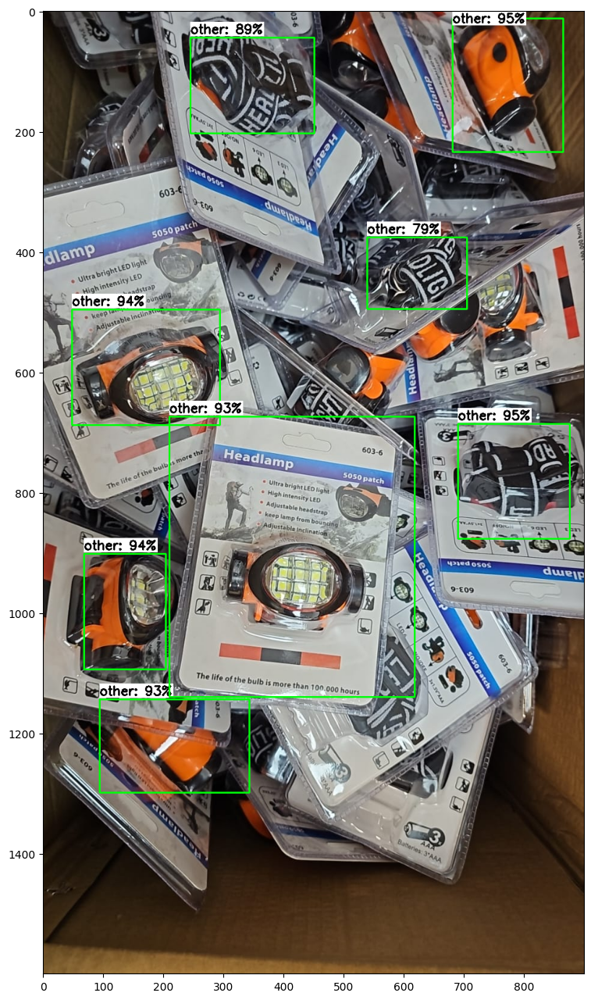

Number of objects detected in 20231121_114711.jpg: 0


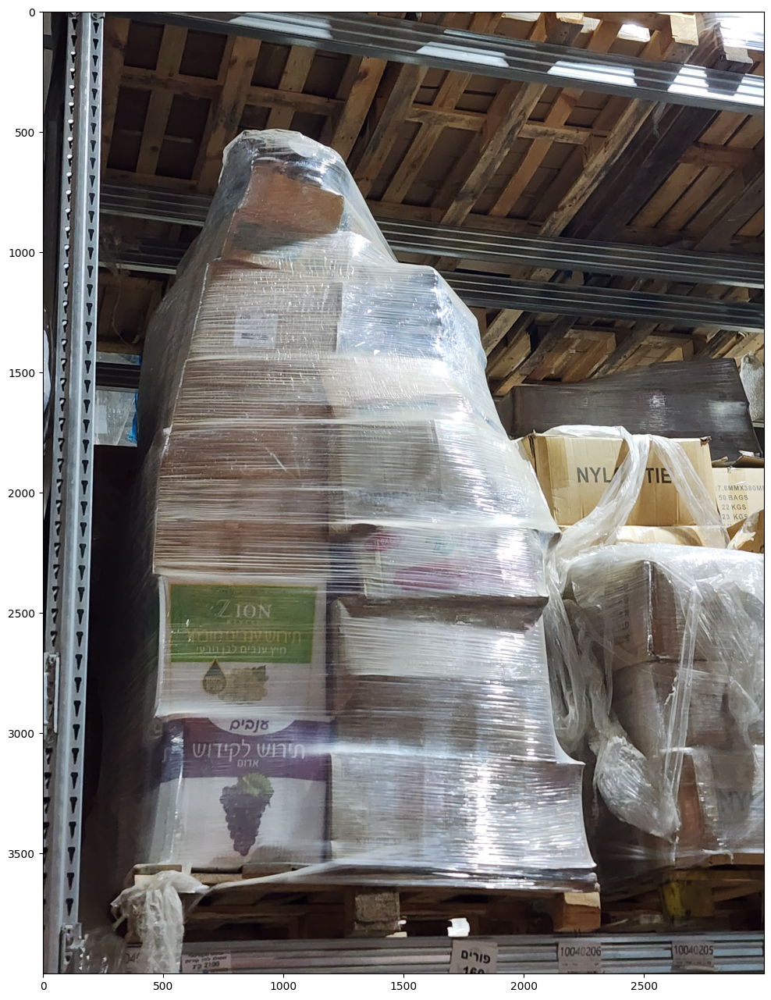

Number of objects detected in 20231121_115612.jpg: 10


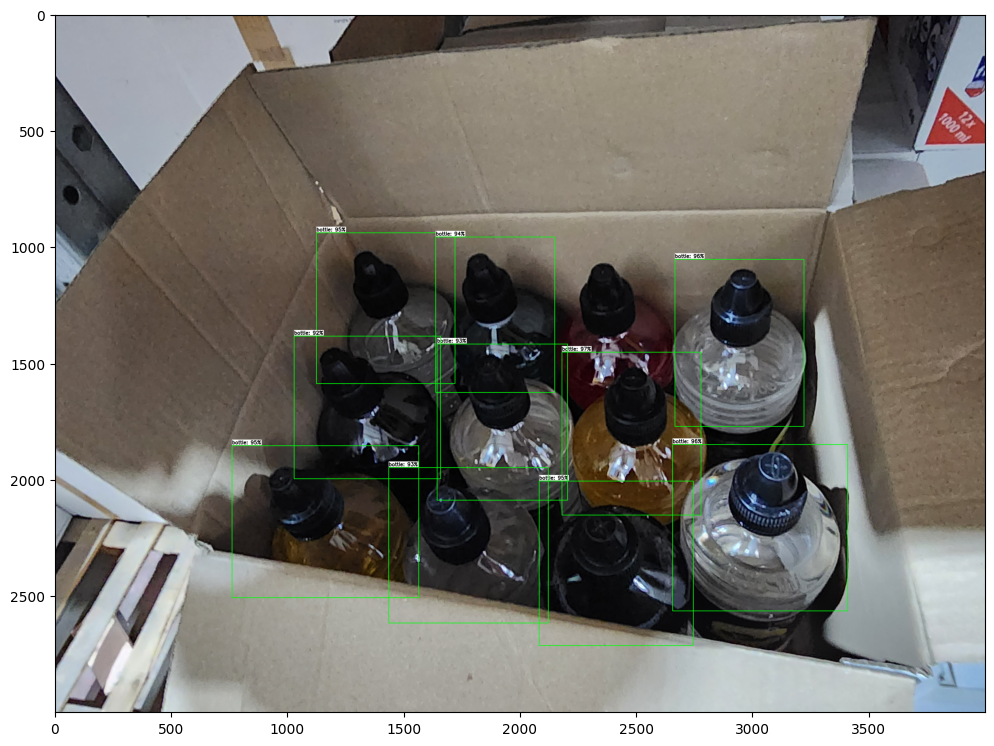

Number of objects detected in 20231121_120042.jpg: 2


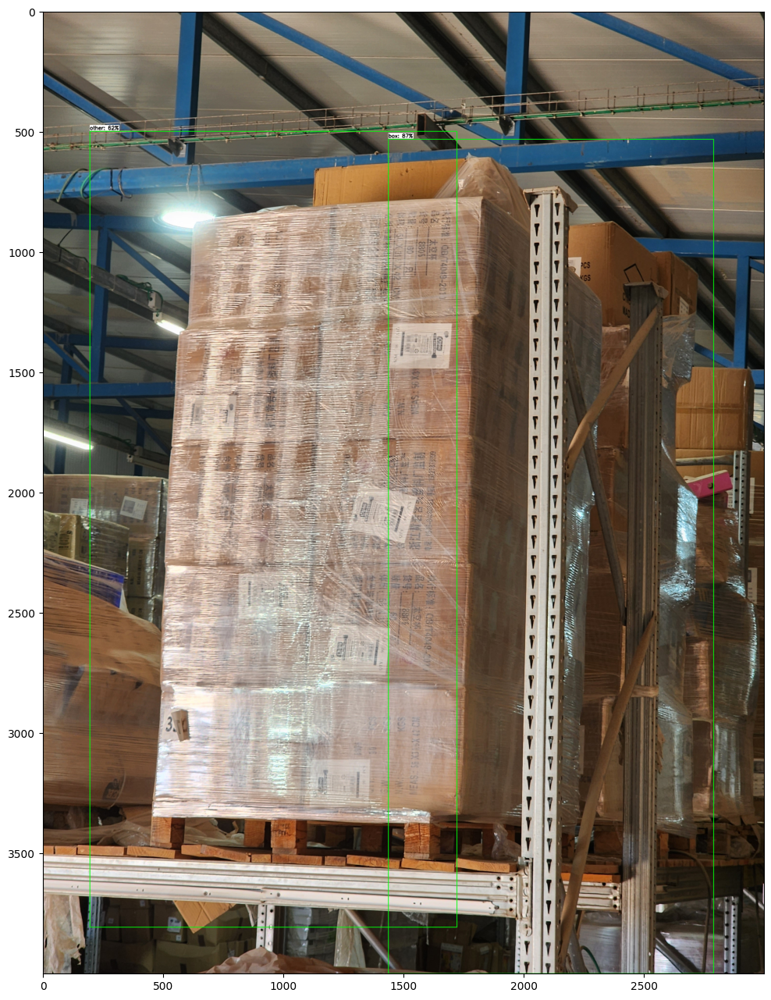

In [22]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/images/test'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/custom_model_lite/custom_model_lite/labelmap.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 10   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)